# **1. Importing the libraries**

In [1]:
# necessary imports
import numpy as np
import pandas as pd
import seaborn as sns
import sklearn as sk
import matplotlib.pyplot as plt
import plotly.express as px
import time
# import umap
import umap.umap_ as umap
# from umap import UMAP
import warnings

from mpl_toolkits.mplot3d import Axes3D
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report
from sklearn.utils import resample
from sklearn.manifold import TSNE, LocallyLinearEmbedding, Isomap
from sklearn.decomposition import PCA, TruncatedSVD
from scipy.sparse import SparseEfficiencyWarning
from warnings import simplefilter
from sklearn.exceptions import ConvergenceWarning
from sklearn.datasets import fetch_openml

%matplotlib inline
sns.set_style('darkgrid')

# **2. Loading the data**

In [2]:
# Reading the csv file
data_mushroom = pd.read_csv("mushroom.csv")
data_mushroom.head()

,cap-shape,cap-surface,cap-color,bruises%3F,odor,gill-attachment,gill-spacing,gill-size,gill-color,stalk-shape,...,stalk-color-above-ring,stalk-color-below-ring,veil-type,veil-color,ring-number,ring-type,spore-print-color,population,habitat,class
0,b'x',b's',b'n',b't',b'p',b'f',b'c',b'n',b'k',b'e',...,b'w',b'w',b'p',b'w',b'o',b'p',b'k',b's',b'u',b'p'
1,b'x',b's',b'y',b't',b'a',b'f',b'c',b'b',b'k',b'e',...,b'w',b'w',b'p',b'w',b'o',b'p',b'n',b'n',b'g',b'e'
2,b'b',b's',b'w',b't',b'l',b'f',b'c',b'b',b'n',b'e',...,b'w',b'w',b'p',b'w',b'o',b'p',b'n',b'n',b'm',b'e'
3,b'x',b'y',b'w',b't',b'p',b'f',b'c',b'n',b'n',b'e',...,b'w',b'w',b'p',b'w',b'o',b'p',b'k',b's',b'u',b'p'
4,b'x',b's',b'g',b'f',b'n',b'f',b'w',b'b',b'k',b't',...,b'w',b'w',b'p',b'w',b'o',b'e',b'n',b'a',b'g',b'e'


# **3. Preprocessing the data**

In [3]:
# Converting the categorical data to numerical format
le = LabelEncoder()
class_column = data_mushroom['class']
label = le.fit_transform(class_column)
data_mushroom = data_mushroom.dropna()
# Using get_dummies to perform one hot encoding
mushroom_df = pd.get_dummies(data_mushroom, columns = data_mushroom.columns[0:-1]) 
u = mushroom_df.select_dtypes(bool)
mushroom_df[u.columns] = u.astype(int)
mushroom_df['class'] = label
mushroom_df

,class,cap-shape_b'b',cap-shape_b'c',cap-shape_b'f',cap-shape_b'k',cap-shape_b's',cap-shape_b'x',cap-surface_b'f',cap-surface_b'g',cap-surface_b's',...,population_b's',population_b'v',population_b'y',habitat_b'd',habitat_b'g',habitat_b'l',habitat_b'm',habitat_b'p',habitat_b'u',habitat_b'w'
0,1,0,0,0,0,0,1,0,0,1,...,1,0,0,0,0,0,0,0,1,0
1,0,0,0,0,0,0,1,0,0,1,...,0,0,0,0,1,0,0,0,0,0
2,0,1,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,1,0,0,0
3,1,0,0,0,0,0,1,0,0,0,...,1,0,0,0,0,0,0,0,1,0
4,0,0,0,0,0,0,1,0,0,1,...,0,0,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8119,0,0,0,0,1,0,0,0,0,1,...,0,0,0,0,0,1,0,0,0,0
8120,0,0,0,0,0,0,1,0,0,1,...,0,1,0,0,0,1,0,0,0,0
8121,0,0,0,1,0,0,0,0,0,1,...,0,0,0,0,0,1,0,0,0,0
8122,1,0,0,0,1,0,0,0,0,0,...,0,1,0,0,0,1,0,0,0,0


This shows us that there's one column which has no correlation with the other columns and won't be an important feature while reducing the dimensions

In [5]:
print(mushroom_df["veil-type_b'p'"].unique())

[1]


All the values of the column veil-type_b'p' are same and thus it won't have any impact on classifying the mushrooms.
So we can remove the column from the dataset.

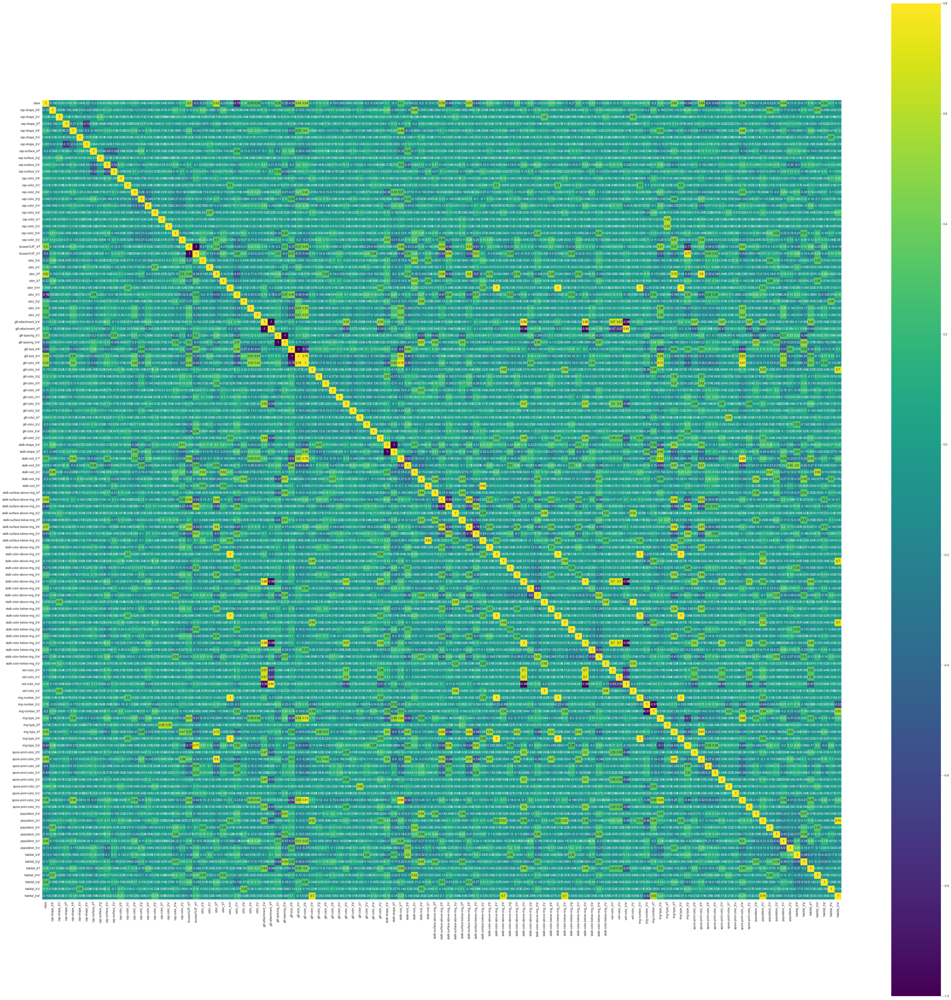

In [6]:
# Dropping the column veil-type_b'p'
mushroom_df.drop("veil-type_b'p'",axis=1,inplace=True)
plt.figure(figsize=(60,60))
sns.heatmap(mushroom_df.corr(),vmax=.8, annot=True,square=True,cmap='viridis')
plt.show()

# **4. Standard Machine Learning**

This is our baseline ML model, when we haven't applied any dimensionality reduction algorithms

Logistic Regression Model:	
 
Accuracy:	 100.0 
Precision:	 100.0 
Recall:	 100.0 
F1-Score: 	 100.0


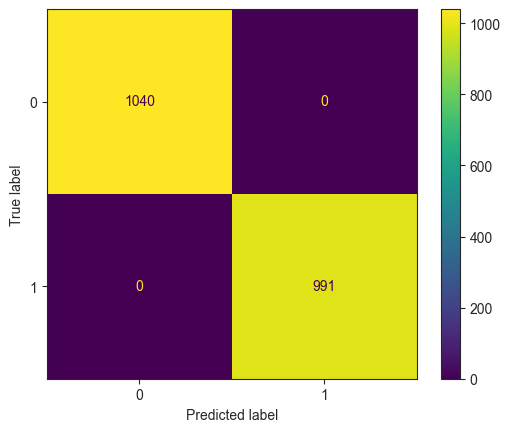

In [7]:
# Applying logistic regression to the original data
x = mushroom_df.iloc[: , 1:].values
y = mushroom_df.iloc[: , 0].values

# Splitting the data into training and testing sets (75% train, 25% test)
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size =0.25, random_state=42)

logistic_model = LogisticRegression(n_jobs=-1, solver='saga', random_state=42)
logistic_model.fit(X_train, y_train)

y_pred = logistic_model.predict(X_test)

sns.set_style("ticks")

# Generating confusion matrix
cm = confusion_matrix(y_pred, y_test)
ConfusionMatrixDisplay(cm).plot()

print('Logistic Regression Model:\t\n',
      '\nAccuracy:\t', accuracy_score(y_test, y_pred)*100,
      '\nPrecision:\t',precision_score(y_test, y_pred)*100,
      '\nRecall:\t', recall_score(y_test, y_pred)*100,
      '\nF1-Score: \t', f1_score(y_test, y_pred)*100,)

# **5. Singular Value Decomposition**

## a. SVD from Scratch

In [8]:
def svd_from_dataframe(dataframe):
    # Convert DataFrame to NumPy array
    X = dataframe.values.astype(float)
    
    # Step 1: Compute the covariance matrix differently
    covariance_matrix = np.dot(X.T, X) / (len(X) - 1)
    
    # Step 2: Compute the eigenvectors and eigenvalues of the covariance matrix
    eigenvalues, eigenvectors = np.linalg.eig(covariance_matrix)
    
    # Step 3: Calculate the singular values and sort them in descending order
    singular_values = np.sqrt(eigenvalues)
    sorted_indices = np.argsort(singular_values)[::-1]
    sorted_singular_values = singular_values[sorted_indices]
    sorted_eigenvectors = eigenvectors[:, sorted_indices]
    
    # Step 4: Construct the sigma matrix
    sigma = np.diag(sorted_singular_values)
    
    # Step 5: Calculate the pseudo-inverse of sigma
    tolerance = 1e-10  # set a tolerance for singular values close to zero
    sigma_pseudo_inverse = np.diag([1/s if s > tolerance else 0 for s in sorted_singular_values])
    
    # Step 6: Calculate U and V matrices
    U = np.dot(X, sorted_eigenvectors) / sorted_singular_values
    V = sorted_eigenvectors
    
    return U, sigma_pseudo_inverse, V.T

# Perform SVD on the DataFrame
U, sigma_pseudo_inverse, V_T = svd_from_dataframe(mushroom_df)

# Reconstruct the original matrix using U, sigma_pseudo_inverse, and V_T
reconstructed_matrix = np.dot(U, np.dot(sigma_pseudo_inverse, V_T))
print("Reconstructed matrix:\n", reconstructed_matrix)


Reconstructed matrix:
 [[-8.76574192e+01+2.73446634e-16j -1.38584712e+01-1.03180097e-15j
  -1.47221678e+01+6.17700102e-16j ...  1.95499918e+02+5.57395192e-15j
   2.25363889e+02-1.73862166e-15j -5.20482556e+02-4.05367571e-17j]
 [-3.86409118e+01-1.90201968e-16j -3.17982521e+01-1.30042644e-16j
  -2.17670967e+01-8.55258501e-17j ...  4.72709278e+01+7.88193805e-16j
   4.72709278e+01-1.46446811e-16j -7.49743878e+01-2.01903316e-15j]
 [ 1.95112341e+01+2.86504100e-16j  2.69445434e+01+2.00578059e-16j
   1.69133879e+01-2.73595587e-16j ... -2.23852928e+01+7.18846689e-16j
  -2.23852928e+01+8.69173312e-17j  5.24461778e+01+1.21210028e-15j]
 ...
 [ 1.36447803e+02+9.46305002e-17j -8.09235709e-01+7.08123625e-16j
   4.53652092e+00+6.82046483e-16j ... -4.64684584e+02-6.23216039e-15j
  -4.64684584e+02+1.73303228e-15j  1.33720674e+03+4.06308065e-15j]
 [-6.78633978e+01-3.39278810e-16j -2.24052416e+01-2.90521773e-16j
  -2.04067302e+01+5.27784370e-17j ...  7.78632684e+01+7.68719332e-16j
   7.78632684e+01+4.1121

Logistic Regression Model:	
 
Accuracy:	 81.63466272772033 
Precision:	 81.33874239350912 
Recall: 	 80.92835519677094 
F1-Score: 	 81.13302984319675


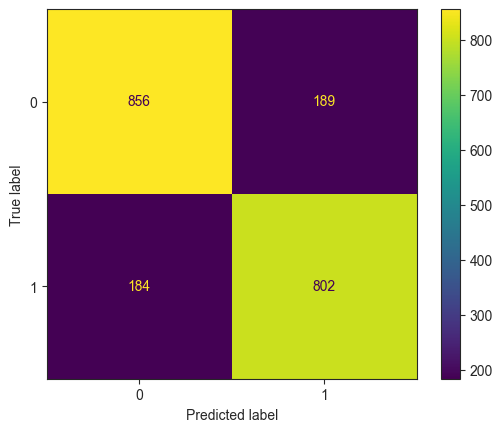

In [9]:
# PLotting the confusion matrix for SVD
simplefilter("ignore", category=ConvergenceWarning)
# Taking the real part of 'reconstructed_matrix' as feature 'x'
x = np.real(reconstructed_matrix)

# 'y' remains the same as before, using the target variable from 'mushroom_df'
y = mushroom_df.iloc[: , 0].values

X_train, X_test, y_train, y_test = train_test_split(x, y, test_size =0.25, random_state=42)

# Standardizing the features using StandardScaler
std = StandardScaler()
X_train = std.fit_transform(X_train)
X_test = std.fit_transform(X_test)

logistic_model = LogisticRegression(n_jobs=-1, solver='saga', random_state=42)
logistic_model.fit(X_train, y_train)

y_pred = logistic_model.predict(X_test)

sns.set_style("ticks")
cm = confusion_matrix(y_pred, y_test)
ConfusionMatrixDisplay(cm).plot()

print('Logistic Regression Model:\t\n',
      '\nAccuracy:\t',accuracy_score(y_test, y_pred)*100,
      '\nPrecision:\t',precision_score(y_test, y_pred)*100,
      '\nRecall: \t',recall_score(y_test, y_pred)*100,
      '\nF1-Score: \t',f1_score(y_test, y_pred)*100,)

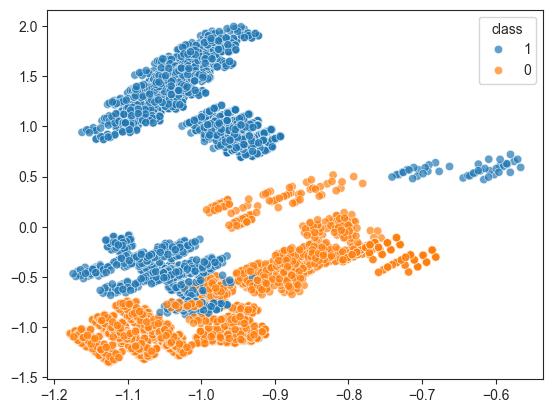

In [10]:
U_2d = U[:, :2]

# Defining the order of the 'hue' variable for plotting 
hue_order = [1,0]
palette=plt.get_cmap('tab10').reversed()
ax = sns.scatterplot(x=-U_2d[:, 0].real, y=-U_2d[:, 1].real, hue=mushroom_df['class'], alpha=0.7, hue_order=hue_order)
plt.show()

## b. SVD using scikit-learn

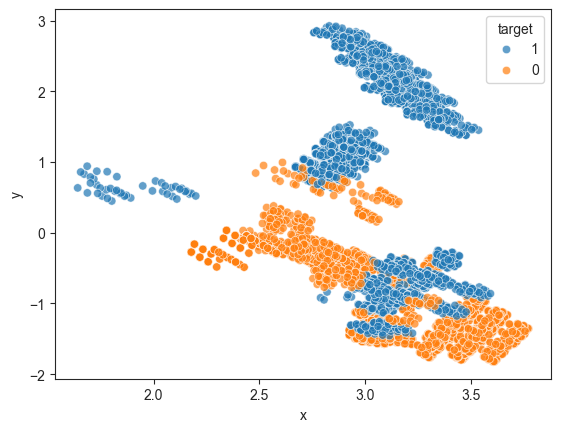

In [11]:
x = mushroom_df.iloc[: , 1:].values
y = mushroom_df.iloc[: , 0].values

# Perform Truncated SVD with 2 components
svd = TruncatedSVD(n_components=2)
svd_data = svd.fit_transform(x)
target = y
svd_df_2 = pd.DataFrame({'target': map(lambda x : str(x),target), 'x': svd_data[:, 0], 'y': svd_data[:, 1]})
svd_df_2.head()

# Plotting the scatter plot
ax = sns.scatterplot(svd_df_2, x='x', y='y', hue='target', alpha=0.7)
plt.show()

In [12]:
x = mushroom_df.iloc[: , 1:].values
y = mushroom_df.iloc[: , 0].values

# Perform Truncated SVD with 3 components
svd = TruncatedSVD(n_components=3)
svd_data = svd.fit_transform(x)
target = y

# Create a DataFrame with SVD-transformed data for 3D scatter plot
svd_df_3 = pd.DataFrame({'target': map(lambda x : str(x),target), 'x': svd_data[:, 0], 'y': svd_data[:, 1], 'z': svd_data[:, 2]})
svd_df_3.head()

# Create a 3D scatter plot using Plotly Express
fig = px.scatter_3d(svd_df_3, x='x', y='y', z='z', color='target', opacity=1)
fig.update_traces(marker=dict(
    size=4,
    line=dict(
        width=0.1,
        color='White')))
fig.update_layout(title='SVD', autosize=False,width=800,height=800)
fig.show()

Logistic Regression Model:	
 
Accuracy:	 88.13392417528311 
Precision:	 96.18226600985221 
Recall: 	 78.80928355196771 
F1-Score: 	 86.63338879645036


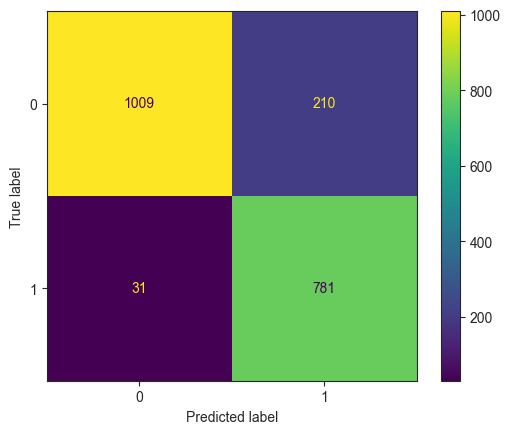

In [13]:
x = svd_df_2.iloc[: , 1:].values
y = svd_df_2.iloc[: , 0].values

X_train, X_test, y_train, y_test = train_test_split(x, y, test_size =0.25, random_state=42)

std = StandardScaler()
X_train = std.fit_transform(X_train)
X_test = std.fit_transform(X_test)

# Fitting the model on the standardized training data
logistic_model = LogisticRegression(n_jobs=-1, solver='saga', random_state=42)
logistic_model.fit(X_train, y_train)

y_pred = logistic_model.predict(X_test)

sns.set_style("ticks")
cm = confusion_matrix(y_pred, y_test)

# Displaying the confusion matrix
ConfusionMatrixDisplay(cm).plot()

print('Logistic Regression Model:\t\n',
      '\nAccuracy:\t',accuracy_score(y_test, y_pred)*100,
      '\nPrecision:\t',precision_score(y_test, y_pred, pos_label='1')*100,
      '\nRecall: \t',recall_score(y_test, y_pred, pos_label='1')*100,
      '\nF1-Score: \t',f1_score(y_test, y_pred, pos_label='1')*100,)

Logistic Regression Model:	
 
Accuracy:	 88.18316100443131 
Precision:	 96.07361963190183 
Recall: 	 79.01109989909183 
F1-Score: 	 86.71096345514951


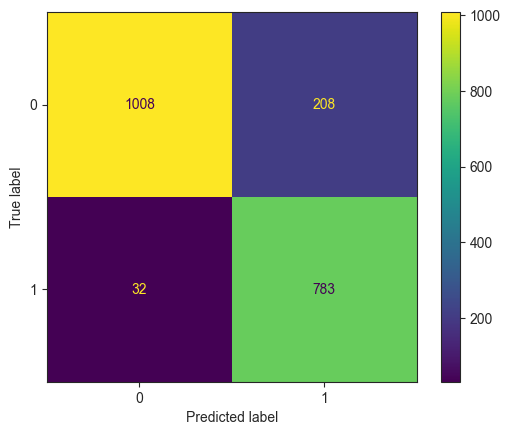

In [14]:
# Extracting features (X) and target variable (y)
x = svd_df_3.iloc[: , 1:].values
y = svd_df_3.iloc[: , 0].values # Target variable is in the first column

X_train, X_test, y_train, y_test = train_test_split(x, y, test_size =0.25, random_state=42)

std = StandardScaler()
X_train = std.fit_transform(X_train)
X_test = std.fit_transform(X_test)

logistic_model = LogisticRegression(n_jobs=-1, solver='saga', random_state=42)
logistic_model.fit(X_train, y_train)

y_pred = logistic_model.predict(X_test)

sns.set_style("ticks")
cm = confusion_matrix(y_pred, y_test)
ConfusionMatrixDisplay(cm).plot()

print('Logistic Regression Model:\t\n',
      '\nAccuracy:\t',accuracy_score(y_test, y_pred)*100,
      '\nPrecision:\t',precision_score(y_test, y_pred, pos_label='1')*100,
      '\nRecall: \t',recall_score(y_test, y_pred, pos_label='1')*100,
      '\nF1-Score: \t',f1_score(y_test, y_pred, pos_label='1')*100,)

# **6. Principle Component Analysis**

## a. PCA from Scratch

In [15]:
def pca_from_dataframe(dataframe, n_components):
    # Convert DataFrame to NumPy array
    X = dataframe.values.astype(float)
    
    # Step 1: Standardize the data
    mean = np.mean(X, axis=0)
    standardized_X = X - mean
    
    # Step 2: Compute the covariance matrix differently
    covariance_matrix = np.dot(standardized_X.T, standardized_X) / (len(standardized_X) - 1)
    
    # Step 3: Compute the eigenvectors and eigenvalues of the covariance matrix
    eigenvalues, eigenvectors = np.linalg.eig(covariance_matrix)
    
    # Step 4: Select the top-k eigenvectors
    indices = np.argsort(eigenvalues)[::-1][:n_components]
    top_eigenvectors = eigenvectors[:, indices]
    
    # Step 5: Transform the data onto the new feature space
    transformed_X = np.dot(standardized_X, top_eigenvectors)
    
    # Create a DataFrame from the transformed data
    columns = [f"PC{i+1}" for i in range(n_components)]
    transformed_df = pd.DataFrame(transformed_X, columns=columns)
    
    return transformed_df

# Perform PCA on the DataFrame
num_components = 2
transformed_data = pca_from_dataframe(mushroom_df, num_components)
transformed_data


,PC1,PC2
0,-0.836748+0.000000j,-0.794157+0.000000j
1,-1.512213+0.000000j,-0.043311+0.000000j
2,-1.606761+0.000000j,-0.276344+0.000000j
3,-0.962237+0.000000j,-0.508387+0.000000j
4,-0.849643+0.000000j,-0.973607+0.000000j
...,...,...
8119,-0.321751+0.000000j,-0.434885+0.000000j
8120,-0.254255+0.000000j,-0.393651+0.000000j
8121,-0.468047+0.000000j,-0.334628+0.000000j
8122,1.872019+0.000000j,-1.722724+0.000000j


Logistic Regression Model:	
 
Accuracy:	 89.16789758739537 
Precision:	 94.36133486766398 
Recall: 	 82.744702320888 
F1-Score: 	 88.17204301075269


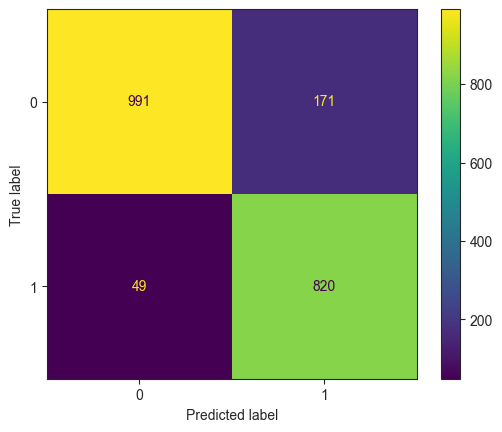

In [16]:
x = np.real(transformed_data)
y = mushroom_df.iloc[: , 0].values

X_train, X_test, y_train, y_test = train_test_split(x, y, test_size =0.25, random_state=42)

std = StandardScaler()
X_train = std.fit_transform(X_train)
X_test = std.fit_transform(X_test)

logistic_model = LogisticRegression(n_jobs=-1, solver='saga', random_state=42)
logistic_model.fit(X_train, y_train)

# Making predictions on the standardized test set
y_pred = logistic_model.predict(X_test)

sns.set_style("ticks")
cm = confusion_matrix(y_pred, y_test)
ConfusionMatrixDisplay(cm).plot()

print('Logistic Regression Model:\t\n',
      '\nAccuracy:\t',accuracy_score(y_test, y_pred)*100,
      '\nPrecision:\t',precision_score(y_test, y_pred)*100,
      '\nRecall: \t',recall_score(y_test, y_pred)*100,
      '\nF1-Score: \t',f1_score(y_test, y_pred)*100,)

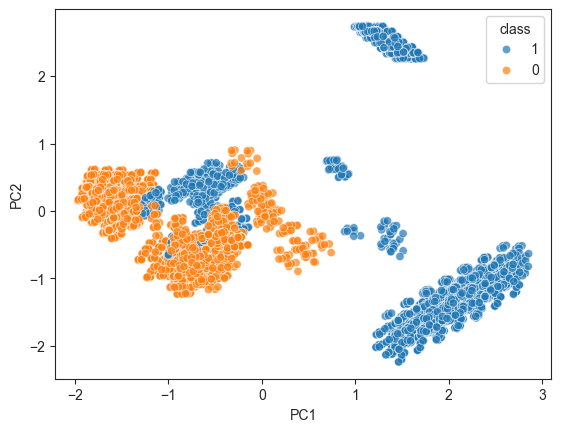

In [17]:
num_components = 2
transformed_data = pca_from_dataframe(mushroom_df, num_components)
# Define order and colors for hue variable
hue_order = [1,0]
palette=plt.get_cmap('tab10').reversed()

# Extracting 'PC1' and 'PC2' from the transformed data
x = transformed_data['PC1'].apply(np.real)
y = transformed_data['PC2'].apply(np.real)

# Creating a scatter plot using Seaborn
ax = sns.scatterplot(x=x, y=y, hue=mushroom_df['class'], alpha=0.7, hue_order=hue_order)
plt.show()

## b. PCA using scikit-learn

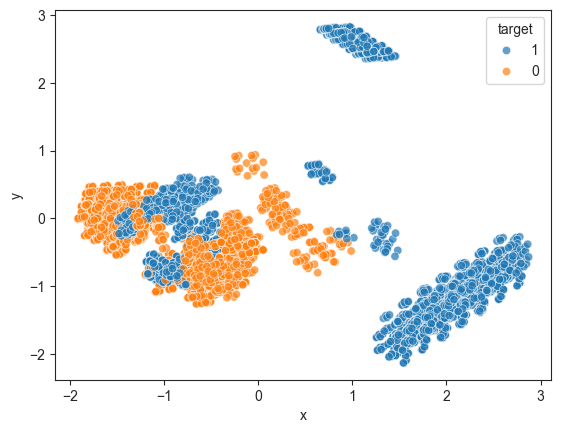

In [18]:
x = mushroom_df.iloc[: , 1:].values
y = mushroom_df.iloc[: , 0].values

target = y

# Applying PCA with 2 components
pca = PCA(n_components=2)
pca_data = pca.fit_transform(x)

# Creating a DataFrame with PCA-transformed data and target labels
pca_df_2 = pd.DataFrame({'target': map(lambda x : str(x),target), 'x': pca_data[:, 0], 'y': pca_data[:, 1]})
pca_df_2.head()

sns.scatterplot(pca_df_2, x='x', y='y', hue='target', alpha=0.7)
plt.show()

In [19]:
x = mushroom_df.iloc[: , 1:].values
y = mushroom_df.iloc[: , 0].values

# Applying PCA with 3 components
pca = PCA(n_components=3)
pca_data = pca.fit_transform(x)
target = y

# Creating a DataFrame with PCA-transformed data and target labels
pca_df_3 = pd.DataFrame({'target': map(lambda x : str(x),target), 'x': pca_data[:, 0], 'y': pca_data[:, 1], 'z': pca_data[:, 2]})
pca_df_3.head()

fig = px.scatter_3d(pca_df_3, x='x', y='y', z='z', color='target', opacity=1)

# Updating marker attributes
fig.update_traces(marker=dict(
    size=4,
    line=dict(
        width=0.1,
        color='White')))

# Updating layout attributes
fig.update_layout(title='PCA', autosize=False,width=800,height=800)
fig.show()

Logistic Regression Model:	
 
Accuracy:	 86.95224027572624 
Precision:	 93.6298076923077 
Recall: 	 78.6074672048436 
F1-Score: 	 85.4635216675809


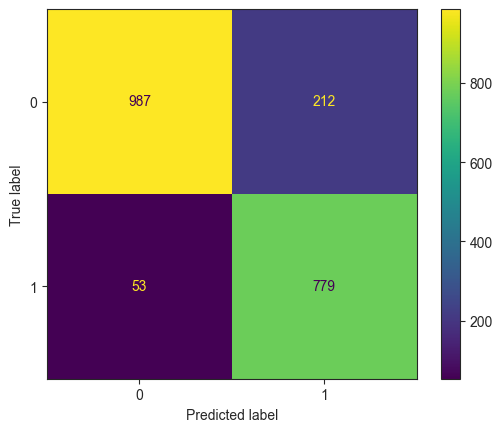

In [20]:
    x = pca_df_2.iloc[: , 1:].values
    y = pca_df_2.iloc[: , 0].values
    
    X_train, X_test, y_train, y_test = train_test_split(x, y, test_size =0.25, random_state=42)
    
    std = StandardScaler()
    X_train = std.fit_transform(X_train)
    X_test = std.fit_transform(X_test)
    
    logistic_model = LogisticRegression(n_jobs=-1, solver='saga', random_state=42)
    logistic_model.fit(X_train, y_train)
    
    y_pred = logistic_model.predict(X_test)
    
    sns.set_style("ticks")
    cm = confusion_matrix(y_pred, y_test)
    ConfusionMatrixDisplay(cm).plot()
    
    print('Logistic Regression Model:\t\n',
          '\nAccuracy:\t',accuracy_score(y_test, y_pred)*100,
          '\nPrecision:\t',precision_score(y_test, y_pred, pos_label='1')*100,
          '\nRecall: \t',recall_score(y_test, y_pred, pos_label='1')*100,
          '\nF1-Score: \t',f1_score(y_test, y_pred, pos_label='1')*100,)

Logistic Regression Model:	
 
Accuracy:	 86.80452978828164 
Precision:	 93.2934131736527 
Recall: 	 78.6074672048436 
F1-Score: 	 85.32311062431545


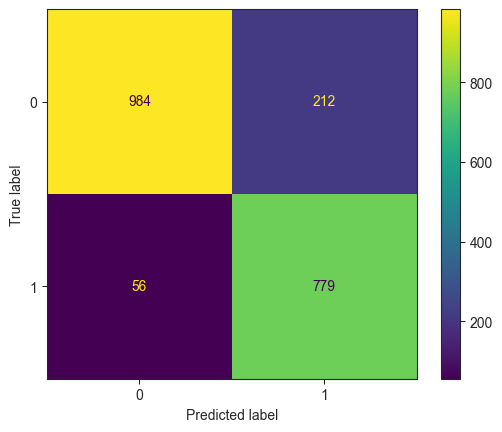

In [21]:
x = pca_df_3.iloc[: , 1:].values
y = pca_df_3.iloc[: , 0].values

X_train, X_test, y_train, y_test = train_test_split(x, y, test_size =0.25, random_state=42)

# Standardizing the features using StandardScaler
std = StandardScaler()
X_train = std.fit_transform(X_train)
X_test = std.fit_transform(X_test)

logistic_model = LogisticRegression(n_jobs=-1, solver='saga', random_state=42)

# Fitting the model on the standardized training data
logistic_model.fit(X_train, y_train)

y_pred = logistic_model.predict(X_test)

sns.set_style("ticks")
cm = confusion_matrix(y_pred, y_test)
ConfusionMatrixDisplay(cm).plot()

print('Logistic Regression Model:\t\n',
      '\nAccuracy:\t',accuracy_score(y_test, y_pred)*100,
      '\nPrecision:\t',precision_score(y_test, y_pred, pos_label='1')*100,
      '\nRecall: \t',recall_score(y_test, y_pred, pos_label='1')*100,
      '\nF1-Score: \t',f1_score(y_test, y_pred, pos_label='1')*100,)

# **7. t-SNE**

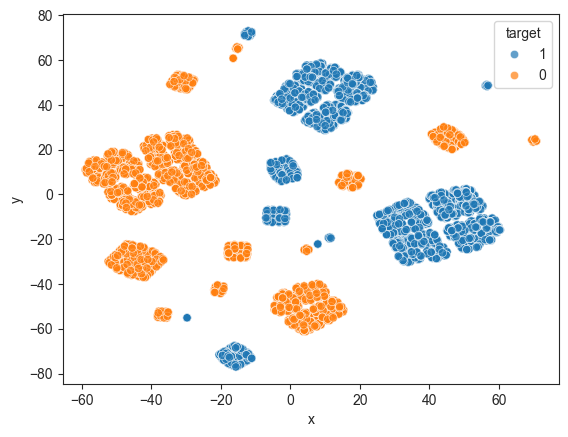

In [22]:

x = mushroom_df.iloc[: , 1:].values
y = mushroom_df.iloc[: , 0].values
target = y

# Applying t-SNE with 2 components for dimensionality reduction
tsne = TSNE(n_components=2)
tsne_data = tsne.fit_transform(x)


tsne_df_2 = pd.DataFrame({'target': map(lambda x : str(x),target), 'x': tsne_data[:, 0], 'y': tsne_data[:, 1]})
sns.scatterplot(tsne_df_2, x='x', y='y', hue='target', alpha=0.7)
plt.show()

In [23]:

x = mushroom_df.iloc[: , 1:].values
y = mushroom_df.iloc[: , 0].values

# Applying t-SNE with 3 components for dimensionality reduction
tsne = TSNE(n_components=3)
tsne_data = tsne.fit_transform(x)

target = y

tsne_df_3 = pd.DataFrame({'target': map(lambda x : str(x),target), 'x': tsne_data[:, 0], 'y': tsne_data[:, 1], 'z': tsne_data[:, 2]})

#Using Plotly to plot 3d 
fig = px.scatter_3d(tsne_df_3, x='x', y='y', z='z', color='target', opacity=1)
fig.update_traces(marker=dict(
    size=4,
    line=dict(
        width=0.1,
        color='White')))
fig.update_layout(title='TSNE', autosize=False,width=800,height=800)
fig.show()

Logistic Regression Model:	
 
Accuracy:	 84.53963564746431 
Precision:	 85.15057113187953 
Recall: 	 82.744702320888 
F1-Score: 	 83.93039918116683


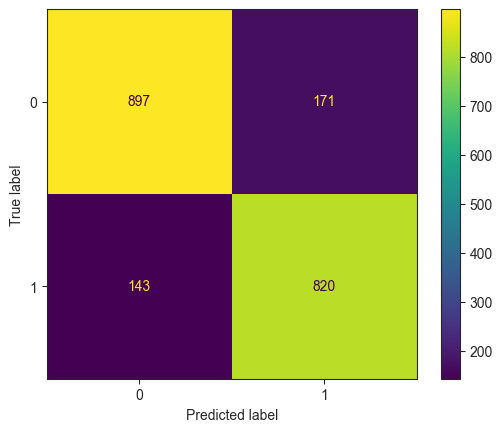

In [24]:
#Printing the confusion matrix for t-SNE resolved to 2 components

x = tsne_df_2.iloc[: , 1:].values
y = tsne_df_2.iloc[: , 0].values

X_train, X_test, y_train, y_test = train_test_split(x, y, test_size =0.25, random_state=42)

std = StandardScaler()
X_train = std.fit_transform(X_train)
X_test = std.fit_transform(X_test)

logistic_model = LogisticRegression(n_jobs=-1, solver='saga', random_state=42)
logistic_model.fit(X_train, y_train)

y_pred = logistic_model.predict(X_test)

sns.set_style("ticks")
cm = confusion_matrix(y_pred, y_test)
ConfusionMatrixDisplay(cm).plot()

print('Logistic Regression Model:\t\n',
      '\nAccuracy:\t',accuracy_score(y_test, y_pred)*100,
      '\nPrecision:\t',precision_score(y_test, y_pred, pos_label='1')*100,
      '\nRecall: \t',recall_score(y_test, y_pred, pos_label='1')*100,
      '\nF1-Score: \t',f1_score(y_test, y_pred, pos_label='1')*100,)

Logistic Regression Model:	
 
Accuracy:	 82.22550467749878 
Precision:	 83.22784810126582 
Recall: 	 79.61654894046418 
F1-Score: 	 81.38215575038679


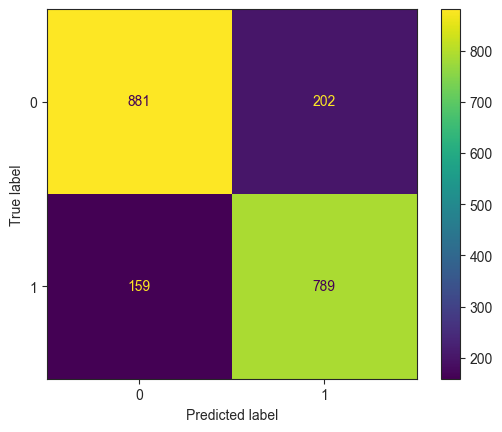

In [25]:
#Printing the confusion matrix for t-SNE resolved to 3 components

x = tsne_df_3.iloc[: , 1:].values
y = tsne_df_3.iloc[: , 0].values

X_train, X_test, y_train, y_test = train_test_split(x, y, test_size =0.25, random_state=42)

std = StandardScaler()
X_train = std.fit_transform(X_train)
X_test = std.fit_transform(X_test)

logistic_model = LogisticRegression(n_jobs=-1, solver='saga', random_state=42)
logistic_model.fit(X_train, y_train)

y_pred = logistic_model.predict(X_test)

sns.set_style("ticks")
cm = confusion_matrix(y_pred, y_test)
ConfusionMatrixDisplay(cm).plot()

print('Logistic Regression Model:\t\n',
      '\nAccuracy:\t',accuracy_score(y_test, y_pred)*100,
      '\nPrecision:\t',precision_score(y_test, y_pred, pos_label='1')*100,
      '\nRecall: \t',recall_score(y_test, y_pred, pos_label='1')*100,
      '\nF1-Score: \t',f1_score(y_test, y_pred, pos_label='1')*100,)

# **8. UMAP**

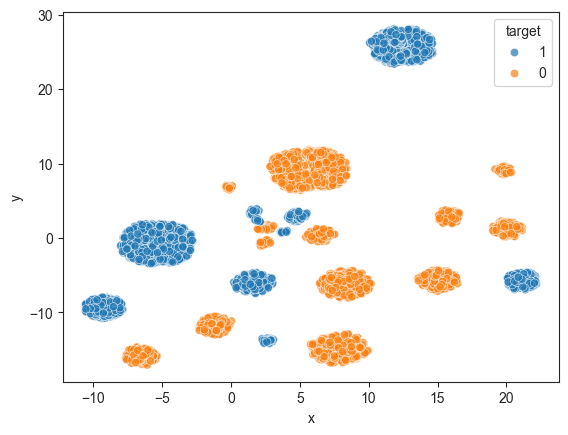

In [26]:
x = mushroom_df.iloc[: , 1:].values
y = mushroom_df.iloc[: , 0].values

# Applying UMAP with 2 components for dimensionality reduction
umap2D = umap.UMAP(n_components=2, n_neighbors = 100, min_dist=0.8) 
umap_data = umap2D.fit_transform(x) 
target = y

umap_df_2 = pd.DataFrame({'target': map(lambda x : str(x),target), 'x': umap_data[:, 0], 'y': umap_data[:, 1]})
sns.scatterplot(umap_df_2, x='x', y='y', hue='target', alpha=0.7)
plt.show()

In [28]:
x = mushroom_df.iloc[: , 1:].values
y = mushroom_df.iloc[: , 0].values

# Applying UMAP with 3 components for dimensionality reduction
umap3D = umap.UMAP(n_components=3, n_neighbors = 100, min_dist=0.8)
umap_data = umap3D.fit_transform(x)

target = y

umap_df_3 = pd.DataFrame({'target': map(lambda x : str(x),target), 'x': umap_data[:, 0], 'y': umap_data[:, 1], 'z': umap_data[:, 2]})

fig = px.scatter_3d(umap_df_3, x='x', y='y', z='z', color='target', opacity=1)
fig.update_traces(marker=dict(
    size=4,
    line=dict(
        width=0.1,
        color='White')))
fig.update_layout(title='UMAP', autosize=False, width=800, height=800)
fig.show()

Logistic Regression Model:	
 
Accuracy:	 76.21861152141803 
Precision:	 71.41652613827993 
Recall: 	 85.46922300706358 
F1-Score: 	 77.81350482315112


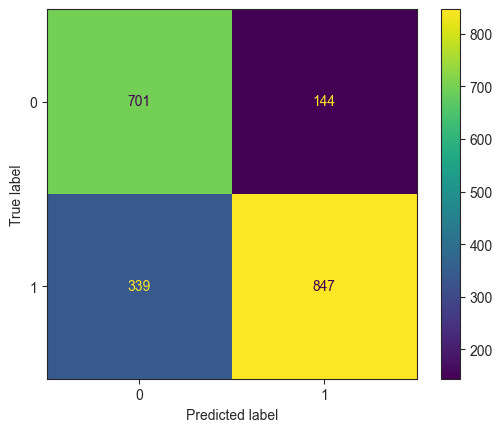

In [29]:
#Plotting confusion matrix for UMAP resolved to 2 dimensions
x = umap_df_2.iloc[: , 1:].values
y = umap_df_2.iloc[: , 0].values

X_train, X_test, y_train, y_test = train_test_split(x, y, test_size =0.25, random_state=42)

std = StandardScaler()
X_train = std.fit_transform(X_train)
X_test = std.fit_transform(X_test)

logistic_model = LogisticRegression(n_jobs=-1, solver='saga', random_state=42)
logistic_model.fit(X_train, y_train)

y_pred = logistic_model.predict(X_test)

sns.set_style("ticks")
cm = confusion_matrix(y_pred, y_test)
ConfusionMatrixDisplay(cm).plot()

print('Logistic Regression Model:\t\n',
      '\nAccuracy:\t',accuracy_score(y_test, y_pred)*100,
      '\nPrecision:\t',precision_score(y_test, y_pred, pos_label='1')*100,
      '\nRecall: \t',recall_score(y_test, y_pred, pos_label='1')*100,
      '\nF1-Score: \t',f1_score(y_test, y_pred, pos_label='1')*100,)

# **9. Comparison of Algorithms**

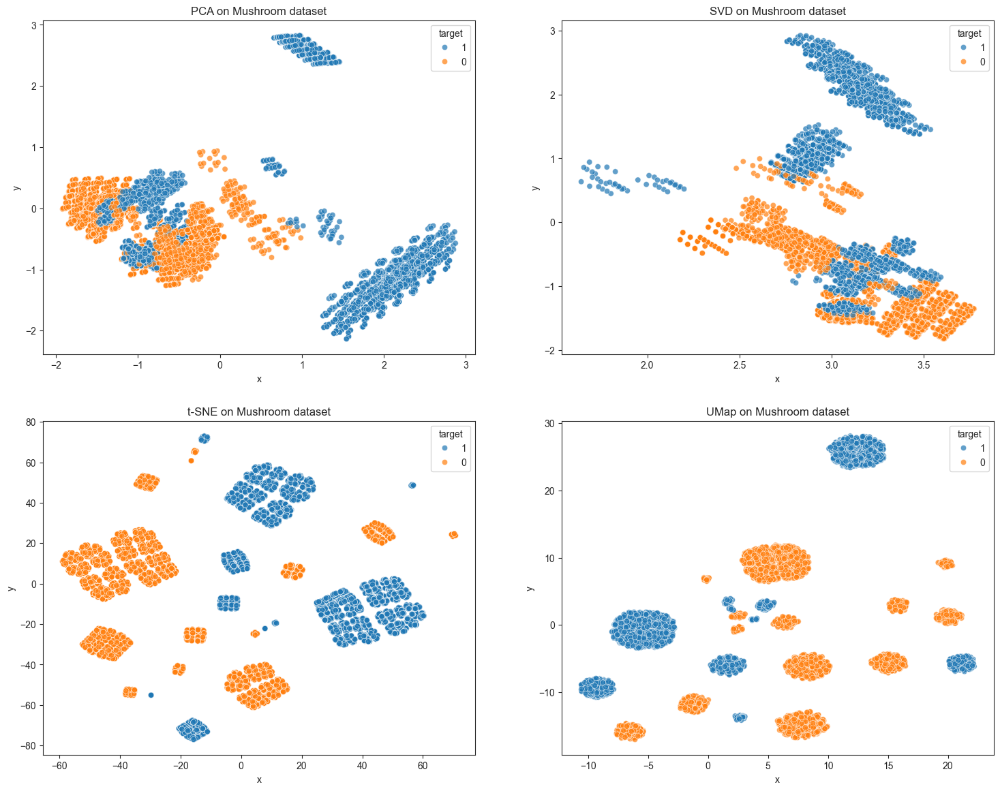

In [30]:
#2x2 grid of scatter plots, displaying the results of different dimensionality reduction techniques
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(nrows=2, ncols=2, figsize=(18, 14))
sns.scatterplot(pca_df_2, x='x', y='y', hue='target', alpha=0.7, ax=ax1)
ax1.set_title("PCA on Mushroom dataset")
sns.scatterplot(svd_df_2, x='x', y='y', hue='target', alpha=0.7, ax=ax2)
ax2.set_title("SVD on Mushroom dataset")
sns.scatterplot(tsne_df_2, x='x', y='y', hue='target', alpha=0.7, ax=ax3)
ax3.set_title("t-SNE on Mushroom dataset")
sns.scatterplot(umap_df_2, x='x', y='y', hue='target', alpha=0.7, ax=ax4)
ax4.set_title("UMap on Mushroom dataset")
plt.show()


In [31]:
#2x2 subplot grid in Plotly to visualize 3D representations of different dimensionality reduction techniques (PCA, SVD, t-SNE, UMAP)

from plotly.graph_objects import Scatter3d
import plotly.graph_objects as go

from plotly.subplots import make_subplots
import numpy as np

import plotly.graph_objects as go
import plotly


color_graph= ['red', 'blue']
# Create a 2x2 subplot grid with specified titles
fig = make_subplots(
    rows=2, cols=2,
    specs=[[{'type': 'scene'}, {'type': 'scene'}],
           [{'type': 'scene'}, {'type': 'scene'}]],
    subplot_titles=('3D representation of PCA',  '3D representation of SVD','3D representation of TSNE', '3D representation of UMAP'))

# For each unique target in PCA, create a Scatter3d trace and add it to the subplot
for s, color_target in zip(pca_df_3.target.unique(), color_graph):
    df = pca_df_3[pca_df_3.target == s]

    fig.add_trace(go.Scatter3d(x=df.x, y=df.y, z=df.z,mode = 'markers',
                               name = s,
                               marker_color = color_target,
                              showlegend=False),
                  row=1, col=1)

# Repeat the same process for SVD, t-SNE, and UMAP, adding traces to respective subplots

for s, color_target in zip(svd_df_3.target.unique(), color_graph):
    df = svd_df_3[svd_df_3.target == s]

    fig.add_trace(go.Scatter3d(x=df.x, y=df.y, z=df.z,mode = 'markers',
                               name = s,
                               marker_color = color_target,
                              showlegend=False),
                  row=1, col=2)


for s, color_target in zip(tsne_df_3.target.unique(), color_graph):
    df = tsne_df_3[tsne_df_3.target == s]

    fig.add_trace(go.Scatter3d(x=df.x, y=df.y, z=df.z,mode = 'markers',
                               name = s,
                               marker_color = color_target,
                              showlegend=False),
                  row=2, col=1)

for s, color_target in zip(umap_df_3.target.unique(), color_graph):
    df = umap_df_3[umap_df_3.target == s]

    fig.add_trace(go.Scatter3d(x=df.x, y=df.y, z=df.z,mode = 'markers',
                               name = s,
                               marker_color = color_target),
                  row=2, col=2)



fig.update_traces(marker=dict(
    size=4,
    line=dict(
        width=0.1,
        color='White')))

fig.update_layout(height=1000, width=1000, title_text="3D Subplots")
fig.show()

# **10. Runtime comparison**

In [32]:
sns.set(context='notebook',
        rc={'figure.figsize':(12,10)},
        palette=sns.color_palette('tab10', 10))

In [33]:
# Loading the Fashion-MNIST dataset using fetch_openml
mnist = fetch_openml('Fashion-MNIST', version=1, parser='auto')

In [34]:
#evaluating the runtime performance 
def data_size_scaling(algorithm, data, sizes=[1000, 2000, 4000, 8000, 16000, 32000, 64000], n_runs=5):
    result = []
    for size in sizes:
        for run in range(n_runs):
            subsample = resample(data, n_samples=size)
            start_time = time.time()
            algorithm.fit(subsample)
            elapsed_time = time.time() - start_time
            del subsample
            result.append((size, elapsed_time))
    return pd.DataFrame(result, columns=('dataset size', 'runtime (s)'))

In [35]:
simplefilter("ignore", category = UserWarning)
all_algorithms = [
    PCA(),
    TruncatedSVD(),
    TSNE(),
    umap.UMAP(),
]

# Dictionary to store performance data for each algorithm
performance_data = {}

# Loop through each algorithm for evaluation
for algorithm in all_algorithms:
    # Extract the name of the algorithm
    alg_name = str(algorithm)
    alg_name = alg_name.split('(')[0]
    
    # Evaluate the algorithm's performance for different dataset sizes using data_size_scaling function
    performance_data[alg_name] = data_size_scaling(algorithm, mnist.data, n_runs=1)

In [36]:
for alg_name, perf_data in performance_data.items():
    print(alg_name)
    print(perf_data)

PCA
   dataset size  runtime (s)
0          1000     1.184910
1          2000     1.461422
2          4000     1.537022
3          8000     2.196149
4         16000     3.048314
5         32000     5.551310
6         64000    10.269197
TruncatedSVD
   dataset size  runtime (s)
0          1000     0.086241
1          2000     0.131238
2          4000     0.213329
3          8000     0.427696
4         16000     0.908610
5         32000     2.082466
6         64000     3.598267
TSNE
   dataset size  runtime (s)
0          1000     4.877335
1          2000    10.840065
2          4000    24.709520
3          8000    55.969479
4         16000   121.518740
5         32000   283.632015
6         64000   659.954535
UMAP
   dataset size  runtime (s)
0          1000     8.026487
1          2000     7.507012
2          4000    17.652540
3          8000    12.817436
4         16000    11.505637
5         32000    20.215688
6         64000    45.097323


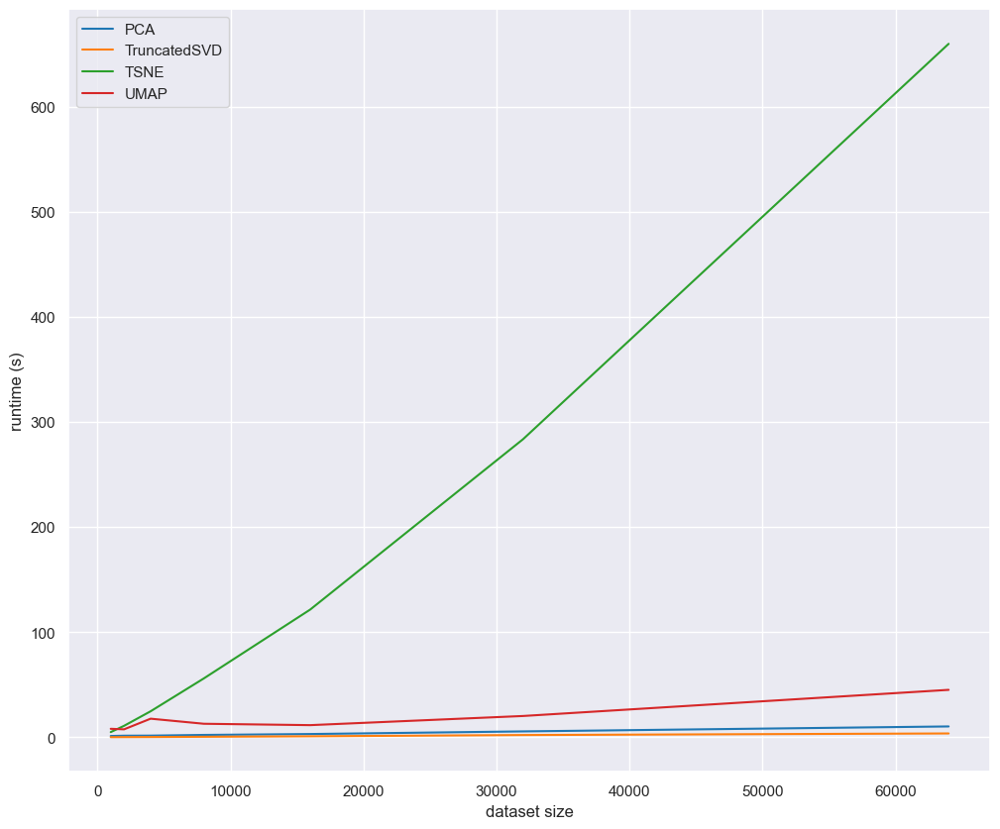

In [37]:
for alg_name, perf_data in performance_data.items():
    sns.lineplot(data = perf_data, x='dataset size', y='runtime (s)', label=alg_name)
plt.legend();

# **11. Some Other Dimensionality Reduction technique**
## ISOMAP

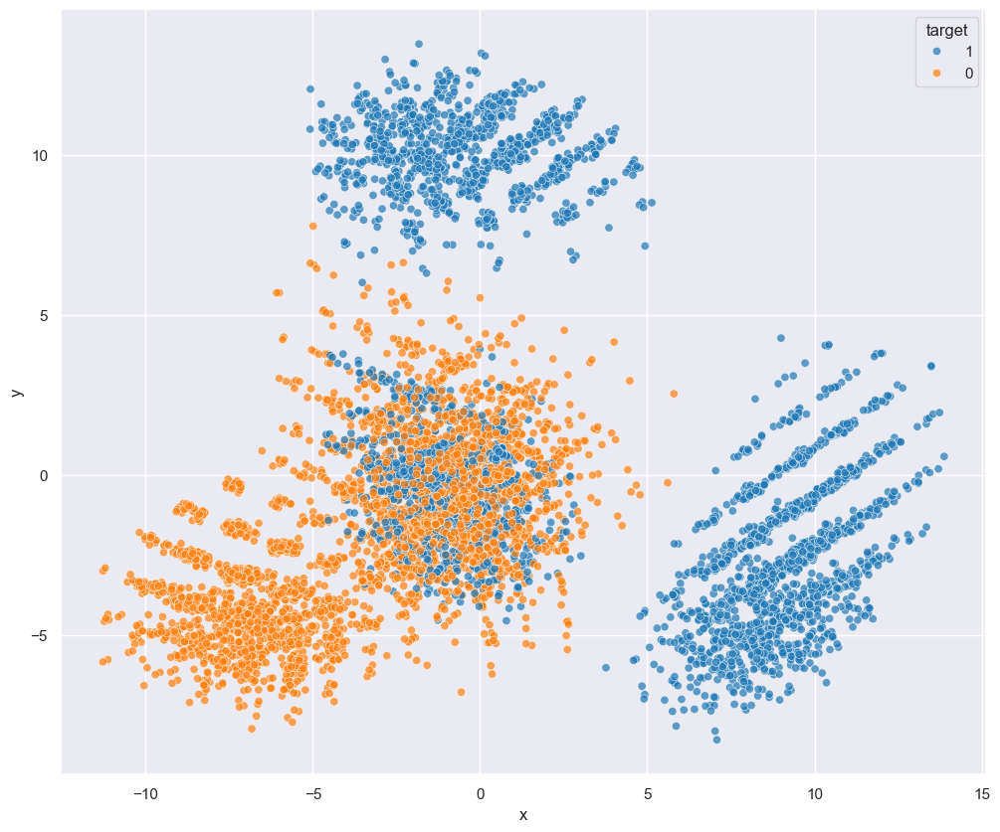

In [38]:
# Ignore SparseEfficiencyWarning and UserWarning
warnings.simplefilter('ignore',SparseEfficiencyWarning)
warnings.simplefilter('ignore',UserWarning)

x = mushroom_df.iloc[: , 1:].values
y = mushroom_df.iloc[: , 0].values
# Applying Isomap with 2 components for dimensionality reduction
isomap = Isomap(n_components=2)
isomap_data = isomap.fit_transform(x)
target = y

# Creating a DataFrame with Isomap-transformed data and target labels
isomap_df_2 = pd.DataFrame({'target': map(lambda x : str(x),target), 'x': isomap_data[:, 0], 'y': isomap_data[:, 1]})
sns.scatterplot(isomap_df_2, x='x', y='y', hue='target', alpha=0.7)
plt.show()

In [44]:
x = mushroom_df.iloc[: , 1:].values
y = mushroom_df.iloc[: , 0].values

# Applying Isomap with 3 components for dimensionality reduction
isomap = Isomap(n_components=3)
isomap_data = isomap.fit_transform(x)
target = y

isomap_df_3 = pd.DataFrame({'target': map(lambda x : str(x),target), 'x': isomap_data[:, 0], 'y': isomap_data[:, 1], 'z': isomap_data[:, 2]})

# Creating a 3D scatter plot using Plotly Express
fig = px.scatter_3d(isomap_df_3, x='x', y='y', z='z', color='target', opacity=1)
fig.update_traces(marker=dict(
    size=4,
    line=dict(
        width=0.1,
        color='White')))

# Updating layout attributes
fig.update_layout(title='ISOMAP', autosize=False, width=800, height=800)
fig.show()